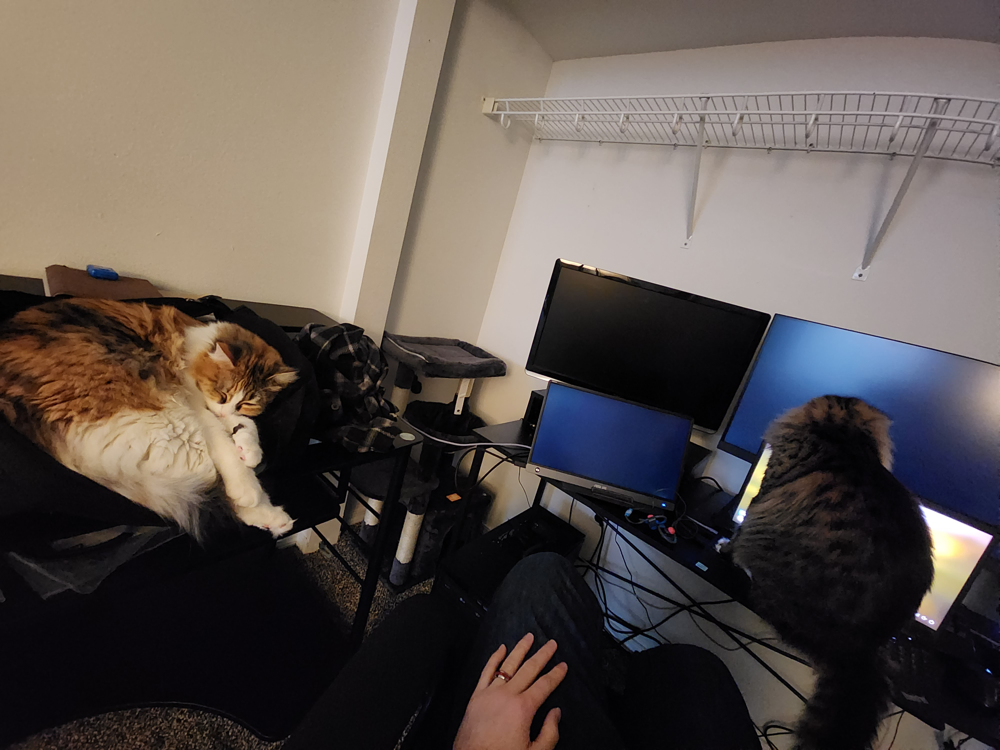

In [1]:
import os
import requests
import json

from dotenv import load_dotenv
from PIL import Image

from PIL import Image, ImageDraw, ImageFont

load_dotenv(override=True)
endpoint = os.environ.get("AZURE_VISION_ENDPOINT")
api_key = os.environ.get("AZURE_VISION_API_KEY")

model_name = 'basickittyobject'

image_path = 'images/test_image.jpg'
with open(image_path, 'rb') as f:
    image_data = f.read()

image = Image.open(image_path)

image

In [22]:
api_version = "2023-02-01-preview"

url = f"{endpoint}/computervision/imageanalysis:analyze?model-name={model_name}&api-version={api_version}"

headers= {
    "Ocp-Apim-Subscription-Key": api_key, 
    "Content-Type": "application/octet-stream" 
}
    
response = requests.post(url, headers=headers, data=image_data)

print(response.text)


{"customModelResult":{"objectsResult":{"values":[{"id":"1","boundingBox":{"x":2907,"y":1585,"w":840,"h":960},"tags":[{"name":"Junipur","confidence":0.85888671875}]},{"id":"2","boundingBox":{"x":10,"y":1184,"w":1184,"h":930},"tags":[{"name":"Autumn","confidence":0.81982421875}]},{"id":"3","boundingBox":{"x":9,"y":1194,"w":1187,"h":928},"tags":[{"name":"Junipur","confidence":0.3525390625}]},{"id":"4","boundingBox":{"x":2907,"y":1585,"w":840,"h":960},"tags":[{"name":"Autumn","confidence":0.302978515625}]},{"id":"5","boundingBox":{"x":1823,"y":2535,"w":446,"h":457},"tags":[{"name":"Junipur","confidence":0.269287109375}]},{"id":"6","boundingBox":{"x":2102,"y":1023,"w":992,"h":708},"tags":[{"name":"Junipur","confidence":0.220947265625}]},{"id":"7","boundingBox":{"x":2439,"y":1583,"w":1344,"h":1390},"tags":[{"name":"Junipur","confidence":0.188720703125}]},{"id":"8","boundingBox":{"x":0,"y":1115,"w":1125,"h":641},"tags":[{"name":"Autumn","confidence":0.159912109375}]}]}},"modelVersion":"2023-0

{'id': '1', 'boundingBox': {'x': 2907, 'y': 1585, 'w': 840, 'h': 960}, 'tags': [{'name': 'Junipur', 'confidence': 0.85888671875}]}
{'id': '2', 'boundingBox': {'x': 10, 'y': 1184, 'w': 1184, 'h': 930}, 'tags': [{'name': 'Autumn', 'confidence': 0.81982421875}]}


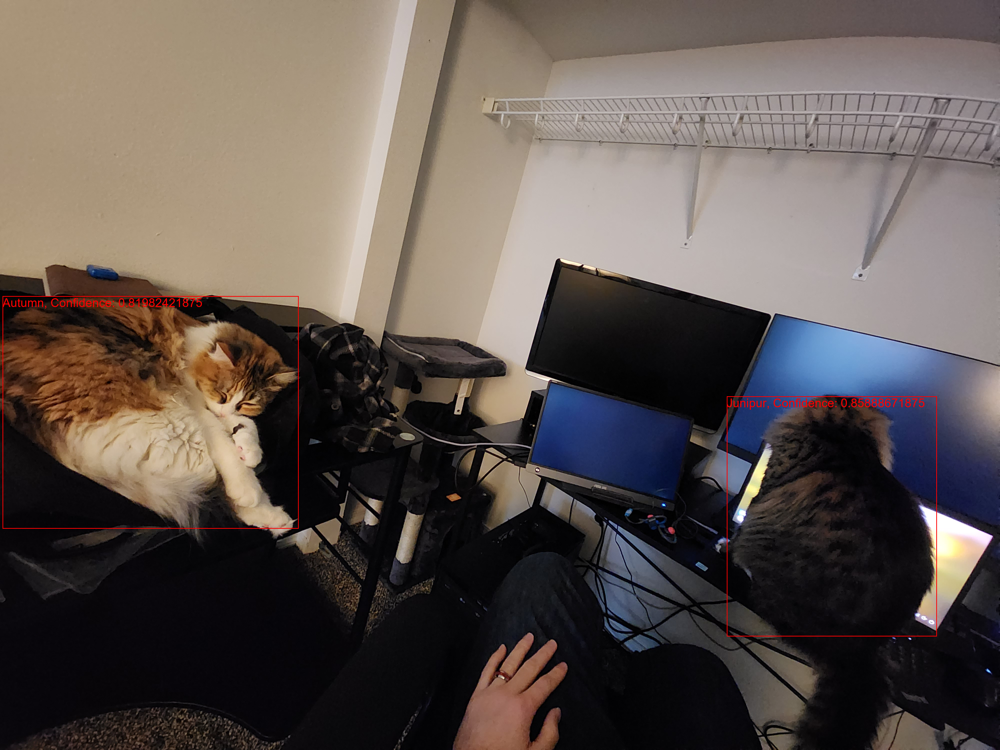

In [23]:
image = Image.open(image_path)
draw = ImageDraw.Draw(image)
font = ImageFont.truetype("arial.ttf", 48)

color = "red"
confidence_threshold = 0.5

detected_objects = json.loads(response.text)["customModelResult"]["objectsResult"]["values"]
filtered_objects = [
    detected_object
    for detected_object in detected_objects
    if detected_object["tags"][0]["confidence"] >= confidence_threshold
]

for detected_object in filtered_objects:
    print(detected_object)

    tags = detected_object["tags"]
    description = " ".join(
        (f"{tag['name']}, Confidence: {tag['confidence']}" for tag in tags)
    )
    coords = detected_object["boundingBox"]
    bounding_box = (
        (coords["x"], coords["y"]),
        (coords["x"] + coords["w"], coords["y"] + coords["h"]),
    )

    draw.text((coords["x"], coords["y"]), description, font=font, fill=color)
    draw.rectangle(bounding_box, outline=color, width=3)

image

#ex. manufacturing "how it's made tomatoes"